<a href="https://colab.research.google.com/github/SaddyMalingu/marautat/blob/main/Writer's_Flow_3_0.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Successful Mounting and Accessing of the Tags Dataset

In [2]:

from google.colab import drive
drive.mount('/content/drive')

MessageError: Error: credential propagation was unsuccessful

In [ ]:

from google.colab import files

# Upload file(s) - you will be prompted to select the file
uploaded = files.upload()

# Specify the destination folder in your Google Drive (e.g., Colab Notebooks folder)
destination_folder = '/content/drive/MyDrive/Colab Notebooks/'

# Move the uploaded file to your Google Drive
for filename in uploaded.keys():
    destination_path = destination_folder + filename
    !mv "{filename}" "{destination_path}"
    print(f"File saved to {destination_path}")

Saving Write for Us Tags.txt to Write for Us Tags.txt
File saved to /content/drive/MyDrive/Colab Notebooks/Write for Us Tags.txt


In [ ]:

file_path = '/content/drive/MyDrive/Colab Notebooks/Write for Us Tags.txt'

# Open the file and read the tags
with open(file_path, 'r') as file:
    tags = file.readlines()

# Clean up the tags (remove newlines and whitespace)
tags = [tag.strip() for tag in tags if tag.strip()]

# Print the first few tags to verify
print(tags[:10])

['" health and nutrition" + "write for us" ""education" + "blogs" + "write for us"" ""guide to" intitle:"write for us"" ""home design" + "write for us"" ""home remoduling ""write for us""" ""home" + "write for us""', '""interior design" + "write for us"" ""internet marketing" intitle:"write for us"" ""kitchen design" + "write for us""', '""law and "write for us""" ""money" + "write for us"" ""packaging"+"write for us""', '""pet care"+"write for us"+"guest post"" ""reasons to" intitle:"write for us"" ""technology" "write for us"" ""technology" + "write for us""', '""write for us " + "apartment living"" ""write for us " + "architecture design"" ""write for us " + "bridal hair""', '""write for us " + "diy""', '""write for us " + "domestic services"" ""write for us " + "family""', '""write for us " + "gardening"" ""write for us " + "home appliance"" ""write for us " + "home automation"" ""write for us " + "home business"" ""write for us " + "home buyers"" ""write for us " + "home design""'

In [ ]:
# prompt: format tags in a  numbered list, tabulated format

import pandas as pd

def format_tags(tags):
    """
    Formats a list of tags into a numbered, tabulated format.

    Args:
        tags: A list of strings representing tags.

    Returns:
        A pandas DataFrame with formatted tags.
    """

    df = pd.DataFrame({'Tag': tags})
    df.index += 1  # Start index from 1
    df.index.name = 'No.'
    return df


# Example usage (assuming 'tags' list is defined from your previous code):
# Assuming 'tags' is already populated from the file reading part of your code.
# (Replace with your actual tags if they're not in that variable)
# Example:
#tags = ["write for us technology", "write for us health", "another tag", "one more"]

# Assuming 'file_path' from the previous code correctly points to the file.

file_path = '/content/drive/MyDrive/Colab Notebooks/Write for Us Tags.txt'
try:
    with open(file_path, 'r') as file:
        tags = file.readlines()
    tags = [tag.strip() for tag in tags if tag.strip()]
    formatted_tags = format_tags(tags)
    print(formatted_tags)

except FileNotFoundError:
    print(f"Error: File not found at {file_path}")
except Exception as e:
    print(f"An error occurred: {e}")

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                   Tag
No.                                                                                                                                                                                                                                              

Processing Tags Data

In [ ]:

import re
import nltk

# Download the 'punkt' tokenizer if not already available
try:
    nltk.data.find('tokenizers/punkt')
except LookupError:
    nltk.download('punkt')

# Download the 'punkt_tab' tokenizer if not already available
# This line is added to resolve the LookupError
try:
    nltk.data.find('tokenizers/punkt_tab')
except LookupError:
    nltk.download('punkt_tab')


# Function to clean and tokenize tags
def process_tags(raw_tags):
    # Remove special characters except for + (which is part of search format)
    cleaned_tags = [re.sub(r'[^a-zA-Z0-9+]', ' ', tag) for tag in raw_tags]

    # Tokenization
    tokenized_tags = [nltk.word_tokenize(tag) for tag in cleaned_tags]

    return tokenized_tags

# Fetch tags from the txt file (assuming file is already uploaded)
file_path = '/content/drive/MyDrive/Colab Notebooks/Write for Us Tags.txt'  # Corrected file path
try:
    with open(file_path, 'r') as file:
        raw_tags = file.readlines()  # Reading each line as a tag
except FileNotFoundError:
    print(f"Error: File not found at {file_path}. Please make sure the file exists and the path is correct.")
    # Handle the error appropriately (e.g., exit the script or use default tags)
    # ...
else:
    # Remove any unnecessary whitespace characters
    raw_tags = [tag.strip() for tag in raw_tags]

    # Clean and tokenize the tags
    cleaned_and_tokenized_tags = process_tags(raw_tags)

    print("Cleaned and Tokenized Tags:")
    for tag in cleaned_and_tokenized_tags:
        print(tag)

    # Continue with your clustering and SERP scraping steps here...

Cleaned and Tokenized Tags:
['health', 'and', 'nutrition', '+', 'write', 'for', 'us', 'education', '+', 'blogs', '+', 'write', 'for', 'us', 'guide', 'to', 'intitle', 'write', 'for', 'us', 'home', 'design', '+', 'write', 'for', 'us', 'home', 'remoduling', 'write', 'for', 'us', 'home', '+', 'write', 'for', 'us']
['interior', 'design', '+', 'write', 'for', 'us', 'internet', 'marketing', 'intitle', 'write', 'for', 'us', 'kitchen', 'design', '+', 'write', 'for', 'us']
['law', 'and', 'write', 'for', 'us', 'money', '+', 'write', 'for', 'us', 'packaging', '+', 'write', 'for', 'us']
['pet', 'care', '+', 'write', 'for', 'us', '+', 'guest', 'post', 'reasons', 'to', 'intitle', 'write', 'for', 'us', 'technology', 'write', 'for', 'us', 'technology', '+', 'write', 'for', 'us']
['write', 'for', 'us', '+', 'apartment', 'living', 'write', 'for', 'us', '+', 'architecture', 'design', 'write', 'for', 'us', '+', 'bridal', 'hair']
['write', 'for', 'us', '+', 'diy']
['write', 'for', 'us', '+', 'domestic', 'se

In [ ]:

import re
import nltk
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
import numpy as np

# Download the 'punkt' tokenizer if not already available
try:
    nltk.data.find('tokenizers/punkt')
except LookupError:
    nltk.download('punkt')

# Function to clean and tokenize tags
def process_tags(raw_tags):
    # Remove special characters except for + (which is part of search format)
    cleaned_tags = [re.sub(r'[^a-zA-Z0-9+]', ' ', tag) for tag in raw_tags]

    # Tokenization
    tokenized_tags = [nltk.word_tokenize(tag) for tag in cleaned_tags]

    return tokenized_tags

# Fetch tags from the txt file (assuming file is already uploaded)
# Corrected file path and file name
file_path = '/content/drive/MyDrive/Colab Notebooks/Write for Us Tags.txt'
with open(file_path, 'r') as file:
    raw_tags = file.readlines()  # Reading each line as a tag

# Remove any unnecessary whitespace characters
raw_tags = [tag.strip() for tag in raw_tags]

# Process the tags (clean and tokenize)
cleaned_and_tokenized_tags = process_tags(raw_tags)

# Use TF-IDF to vectorize the tags
vectorizer = TfidfVectorizer()
X = vectorizer.fit_transform([" ".join(tag) for tag in cleaned_and_tokenized_tags])

# Determine the number of clusters dynamically
# (use min to ensure n_clusters <= n_samples)
n_clusters = min(3, X.shape[0])  # You can adjust the number of clusters based on your needs

# Apply KMeans clustering
kmeans = KMeans(n_clusters=n_clusters, random_state=0).fit(X)

# Cluster assignments
clusters = kmeans.labels_

# Organize tags into clusters
tag_clusters = {i: [] for i in range(n_clusters)}
for i, tag in enumerate(raw_tags):
    tag_clusters[clusters[i]].append(tag)

# Print the clusters
print("Tags Organized into Clusters:")
for cluster_id, tags_in_cluster in tag_clusters.items():
    print(f"Cluster {cluster_id}: {tags_in_cluster}")

Tags Organized into Clusters:
Cluster 0: ['" health and nutrition" + "write for us" ""education" + "blogs" + "write for us"" ""guide to" intitle:"write for us"" ""home design" + "write for us"" ""home remoduling ""write for us""" ""home" + "write for us""', '""write for us " + "gardening"" ""write for us " + "home appliance"" ""write for us " + "home automation"" ""write for us " + "home business"" ""write for us " + "home buyers"" ""write for us " + "home design""', '""write for us " + "home improvement"" ""write for us " + "home remodelling"" ""write for us " + "home renovation"" ""write for us " + "house plan""', '""write for us" "home improvement"" ""write for us" + "business""', '', '""write for us" + "home decoration"" ""write for us" + "home design"" ""write for us" + "home designing"" ""write for us" + "home improvement"" ""write for us" + "indoor""', '""write for us" + home decoration" ""write for us" + home design" ""write for us" + home improvement" ""write for us" + home re

In [ ]:

!pip install sentence-transformers

from sentence_transformers import SentenceTransformer
from sklearn.metrics.pairwise import cosine_similarity
import requests
from requests.adapters import HTTPAdapter
from urllib3.util.retry import Retry

# Configure the requests library globally for retries
retries = Retry(total=5, backoff_factor=1, status_forcelist=[500, 502, 503, 504])
adapter = HTTPAdapter(max_retries=retries)
requests.Session().mount('https://', adapter)

# Initialize the model without session argument
model = SentenceTransformer('all-MiniLM-L6-v2')

# Assuming 'cleaned_and_tokenized_tags' is defined from your previous code
tag_embeddings = model.encode([" ".join(tag) for tag in cleaned_and_tokenized_tags])

# Compute cosine similarity
similarities = cosine_similarity(tag_embeddings)

# Organize tags based on similarity scores
threshold = 0.7
similar_tag_groups = []

for i, tag in enumerate(tags):  # Assuming 'tags' is defined
    group = [tags[i]]
    for j in range(len(tags)):
        if i != j and similarities[i][j] > threshold:
            group.append(tags[j])
    similar_tag_groups.append(group)

print("Tags Organized by Semantic Similarity:")
for group in similar_tag_groups:
    print(group)

Tags Organized by Semantic Similarity:
['" health and nutrition" + "write for us" ""education" + "blogs" + "write for us"" ""guide to" intitle:"write for us"" ""home design" + "write for us"" ""home remoduling ""write for us""" ""home" + "write for us""', '""write for us " + "gardening"" ""write for us " + "home appliance"" ""write for us " + "home automation"" ""write for us " + "home business"" ""write for us " + "home buyers"" ""write for us " + "home design""', '""write for us" + "interior design"" ""write for us" + "interior"" ""write for us" + "outdoor""', '""write for us" + gardening" ""write for us" + general" ""write for us" + health" ""write for us" + home decor"', '""write for us" + home decoration" ""write for us" + home design" ""write for us" + home improvement" ""write for us" + home remodelling" ""write for us" + interior design" ""write for us" + marketing"', '""write for us" + mental health paid" ""write for us" + tech blog"', '"digital marketing "write for us"" "diy 

In [ ]:

# Assuming tags have already been fetched from the file as 'raw_tags'

# Heuristic-based categorization with priority for paid opportunities
paid_tags = [
    tag for tag in raw_tags
    if 'paid' in tag.lower() or 'get paid' in tag.lower() or 'we pay' in tag.lower()
    or 'we will pay' in tag.lower() or 'paid contribution' in tag.lower()
]

write_for_us_tags = [tag for tag in raw_tags if 'write+for+us' in tag.lower() or 'write for us' in tag.lower()]
guest_post_tags = [tag for tag in raw_tags if 'guest+post' in tag.lower() or 'guest post' in tag.lower()]

# Save the categorized tags to separate files in Google Drive
paid_file_path = '/content/drive/MyDrive/Colab Notebooks/paid.txt'
with open(paid_file_path, 'w') as file:
    for tag in paid_tags:
        file.write(tag + '\n')
print(f"Paid tags saved to: {paid_file_path}")


write_for_us_file_path = '/content/drive/MyDrive/Colab Notebooks/write_for_us.txt'
with open(write_for_us_file_path, 'w') as file:
    for tag in write_for_us_tags:
        file.write(tag + '\n')
print(f"Write for us tags saved to: {write_for_us_file_path}")


guest_posts_file_path = '/content/drive/MyDrive/Colab Notebooks/guest_posts.txt'
with open(guest_posts_file_path, 'w') as file:
    for tag in guest_post_tags:
        file.write(tag + '\n')
print(f"Guest post tags saved to: {guest_posts_file_path}")


# Print the prioritized categories
print("Paid Tags (Prioritized):")
for tag in paid_tags:
    print(tag)

print("\nWrite for Us Tags:")
for tag in write_for_us_tags:
    print(tag)

print("\nGuest Post Tags:")
for tag in guest_post_tags:
    print(tag)

Paid tags saved to: /content/drive/MyDrive/Colab Notebooks/paid.txt
Write for us tags saved to: /content/drive/MyDrive/Colab Notebooks/write_for_us.txt
Guest post tags saved to: /content/drive/MyDrive/Colab Notebooks/guest_posts.txt
Paid Tags (Prioritized):
""write for us" + mental health paid" ""write for us" + tech blog"
""write for us" fashion" ""write for us" fitness" ""write for us" food" ""write for us" free" ""write for us" health paid"
""write for us" marketing" ""write for us" seo" ""write for us" tech" ""write for us" technology" ""write for us" travel paid" ""write for us" travel" ""write for us""
"general data protection regulation" and "write for us" "get paid to write for us" inspiration
"get paid to write for us" motivation "granada hills" write for us "graphic artist + write for us" "graphic design "write for us""
"self improvement" and "write for us and get paid"
"write for us + "exterior design"" "write for us + "interior design"" "write for us + grandparents" "write 

In [ ]:

import pandas as pd

# Assuming 'tags' and 'clusters' are already defined

# Ensure that the lengths of 'tags' and 'clusters' are the same
# Before creating the DataFrame, trim the longer array/list to match the shorter one
min_len = min(len(tags), len(clusters))
tags = tags[:min_len]
clusters = clusters[:min_len]

# Now create the DataFrame
df = pd.DataFrame({'Tags': tags, 'Cluster': clusters})

# Save to CSV (path adjusted for better organization)
df.to_csv('/content/drive/MyDrive/Colab Notebooks/organized_tags.csv', index=False)

print("Tags saved to organized_tags.csv")

Tags saved to organized_tags.csv


In [ ]:

# For data processing and visualization
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
import nltk
nltk.download('punkt')
nltk.download('stopwords')
from nltk.corpus import stopwords

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [ ]:

import pandas as pd
import nltk
from nltk.corpus import stopwords
import re

# Assume 'tags' is a list of tag strings from the previous steps.
stop_words = set(stopwords.words('english'))

# Function to clean and process tags
def clean_tags(tag_list):
    processed_tags = []
    for tag in tag_list:
        words = nltk.word_tokenize(tag)
        words = [word.lower() for word in words if word.isalpha() and word.lower() not in stop_words]
        processed_tags.append(' '.join(words))
    return processed_tags

# Load raw tags from file (if not already in memory)
file_path = '/content/drive/MyDrive/Colab Notebooks/Write for Us Tags.txt'
try:
    with open(file_path, 'r') as file:
        raw_tags = file.readlines()  # Reading each line as a tag
except FileNotFoundError:
    print(f"Error: File not found at {file_path}. Please make sure the file exists and the path is correct.")
    raw_tags = []

# Remove any unnecessary whitespace characters
raw_tags = [tag.strip() for tag in raw_tags]

# Clean the original tags
cleaned_tags = clean_tags(raw_tags)  # Cleaned tags

# Heuristic-based categorization with priority for paid opportunities
paid_tags = [
    tag for tag in raw_tags
    if 'paid' in tag.lower() or 'get paid' in tag.lower() or 'we pay' in tag.lower()
    or 'we will pay' in tag.lower() or 'paid contribution' in tag.lower()
]

write_for_us_tags = [tag for tag in raw_tags if 'write+for+us' in tag.lower() or 'write for us' in tag.lower()]
guest_post_tags = [tag for tag in raw_tags if 'guest+post' in tag.lower() or 'guest post' in tag.lower()]

# Clean categorized tags
cleaned_paid_tags = clean_tags(paid_tags)
cleaned_write_for_us_tags = clean_tags(write_for_us_tags)
cleaned_guest_post_tags = clean_tags(guest_post_tags)

# Save the categorized tags to separate files in Google Drive
paid_file_path = '/content/drive/MyDrive/Colab Notebooks/paid.txt'
with open(paid_file_path, 'w') as file:
    for tag in cleaned_paid_tags:
        file.write(tag + '\n')
print(f"Cleaned paid tags saved to: {paid_file_path}")


write_for_us_file_path = '/content/drive/MyDrive/Colab Notebooks/write_for_us.txt'
with open(write_for_us_file_path, 'w') as file:
    for tag in cleaned_write_for_us_tags:
        file.write(tag + '\n')
print(f"Cleaned write for us tags saved to: {write_for_us_file_path}")


guest_posts_file_path = '/content/drive/MyDrive/Colab Notebooks/guest_posts.txt'
with open(guest_posts_file_path, 'w') as file:
    for tag in cleaned_guest_post_tags:
        file.write(tag + '\n')
print(f"Cleaned guest post tags saved to: {guest_posts_file_path}")

Cleaned paid tags saved to: /content/drive/MyDrive/Colab Notebooks/paid.txt
Cleaned write for us tags saved to: /content/drive/MyDrive/Colab Notebooks/write_for_us.txt
Cleaned guest post tags saved to: /content/drive/MyDrive/Colab Notebooks/guest_posts.txt


In [ ]:

# Initialize a TF-IDF Vectorizer
tfidf_vectorizer = TfidfVectorizer()

# Fit the TF-IDF model to the cleaned tags
tfidf_matrix = tfidf_vectorizer.fit_transform(cleaned_tags)

print(f"Shape of TF-IDF matrix: {tfidf_matrix.shape}")

Shape of TF-IDF matrix: (1568, 2055)


In [ ]:

# Set the number of clusters (you can adjust this based on your needs)
num_clusters = 5

# Apply KMeans clustering
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
kmeans.fit(tfidf_matrix)

# Get the cluster labels
clusters = kmeans.labels_

# Add the tags and their corresponding clusters to a DataFrame for easy viewing
clustered_tags_df = pd.DataFrame({'Tag': cleaned_tags, 'Cluster': clusters})
print(clustered_tags_df.head())

                                                                                                                                     Tag  Cluster
0  health nutrition write us education blogs write us guide intitle write us home design write us home remoduling write us home write us        0
1                                                   interior design write us internet marketing intitle write us kitchen design write us        1
2                                                                                         law write us money write us packaging write us        1
3                                          pet care write us guest post reasons intitle write us technology write us technology write us        2
4                                                            write us apartment living write us architecture design write us bridal hair        1


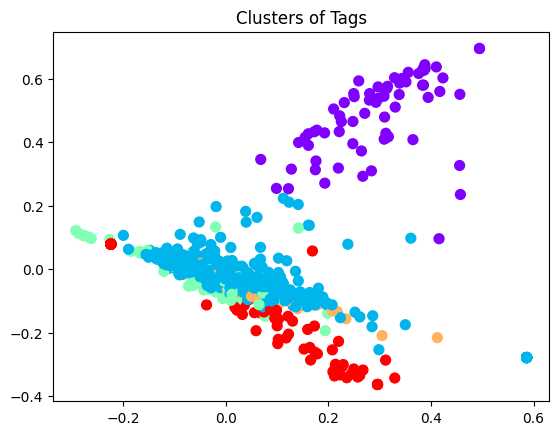

In [ ]:

# Perform PCA to reduce dimensionality for visualization
pca = PCA(n_components=2)
reduced_data = pca.fit_transform(tfidf_matrix.toarray())

# Plot the clusters
plt.scatter(reduced_data[:, 0], reduced_data[:, 1], c=clusters, cmap='rainbow', s=50)
plt.title('Clusters of Tags')
plt.show()

In [ ]:

from gensim.models import Word2Vec
import nltk
import numpy as np

nltk.download('punkt')

# Tokenize the tags into words
tokenized_tags = [nltk.word_tokenize(tag) for tag in cleaned_tags]

# Train Word2Vec model on tokenized tags
word2vec_model = Word2Vec(tokenized_tags, vector_size=100, window=5, min_count=1, workers=4)

# Create vectors for each tag by averaging the word vectors, handling empty tags
tag_vectors = []
for tag in tokenized_tags:
    if tag:  # Check if the tag is not empty
        # Get word vectors for words in the tag that are in the model's vocabulary
        word_vectors = [word2vec_model.wv[word] for word in tag if word in word2vec_model.wv]

        # If there are any word vectors for the tag, calculate the mean
        if word_vectors:
            vector = np.mean(word_vectors, axis=0)
        else:
            # If no words in the tag are in the vocabulary, use a zero vector
            vector = np.zeros(word2vec_model.vector_size)
    else:
        # If the tag is empty, use a zero vector
        vector = np.zeros(word2vec_model.vector_size)
    tag_vectors.append(vector)

# Convert to NumPy array for clustering
tag_vectors = np.array(tag_vectors)

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [ ]:

from sentence_transformers import SentenceTransformer

# Load pre-trained BERT model for sentence embeddings
bert_model = SentenceTransformer('paraphrase-MiniLM-L6-v2')

# Get embeddings for each tag
tag_embeddings = bert_model.encode(cleaned_tags)

# Convert to NumPy array for clustering
tag_embeddings = np.array(tag_embeddings)

In [ ]:

# Adjust the number of clusters as necessary
num_clusters = 5

# Apply KMeans clustering to the embeddings
kmeans_embeddings = KMeans(n_clusters=num_clusters, random_state=42)
kmeans_embeddings.fit(tag_embeddings)  # Or tag_vectors if using Word2Vec

# Get the cluster labels
clusters_embeddings = kmeans_embeddings.labels_

# View the results in a DataFrame
clustered_tags_embeddings_df = pd.DataFrame({'Tag': cleaned_tags, 'Cluster': clusters_embeddings})
print(clustered_tags_embeddings_df.head())

                                                                                                                                     Tag  Cluster
0  health nutrition write us education blogs write us guide intitle write us home design write us home remoduling write us home write us        3
1                                                   interior design write us internet marketing intitle write us kitchen design write us        3
2                                                                                         law write us money write us packaging write us        1
3                                          pet care write us guest post reasons intitle write us technology write us technology write us        2
4                                                            write us apartment living write us architecture design write us bridal hair        3


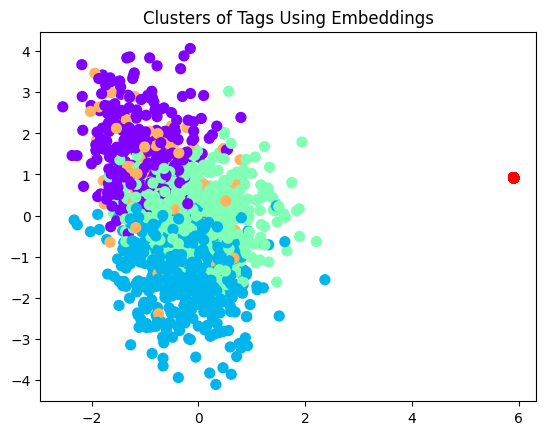

In [ ]:

# Perform PCA to reduce dimensionality
pca_embeddings = PCA(n_components=2)
reduced_embeddings = pca_embeddings.fit_transform(tag_embeddings)

# Plot the clusters
plt.scatter(reduced_embeddings[:, 0], reduced_embeddings[:, 1], c=clusters_embeddings, cmap='rainbow', s=50)
plt.title('Clusters of Tags Using Embeddings')
plt.show()

In [ ]:

# Inspect the first few rows of the DataFrame to see how the tags are clustered
print(clustered_tags_embeddings_df.head())

# Optionally, view tags in a specific cluster
cluster_num = 0  # Change this number to inspect different clusters
cluster_tags = clustered_tags_embeddings_df[clustered_tags_embeddings_df['Cluster'] == cluster_num]
print(f"Tags in Cluster {cluster_num}:")
print(cluster_tags['Tag'].to_list())

                                                                                                                                     Tag  Cluster
0  health nutrition write us education blogs write us guide intitle write us home design write us home remoduling write us home write us        3
1                                                   interior design write us internet marketing intitle write us kitchen design write us        3
2                                                                                         law write us money write us packaging write us        1
3                                          pet care write us guest post reasons intitle write us technology write us technology write us        2
4                                                            write us apartment living write us architecture design write us bridal hair        3
Tags in Cluster 0:
['write us mental health paid write us tech blog', 'write us wedding blog write us wedding design write u

In [ ]:

# Iterate through all clusters and inspect tags
for cluster in range(num_clusters):
    print(f"\nCluster {cluster}:")
    cluster_tags = clustered_tags_embeddings_df[clustered_tags_embeddings_df['Cluster'] == cluster]
    print(cluster_tags['Tag'].to_list())


Cluster 0:
['write us mental health paid write us tech blog', 'write us wedding blog write us wedding design write us wedding ideas write us beauty', 'blog marketing write us blog astronomy write us board games write us boating write us', 'business write us business write us business intitle write us business blogs write us business coaching write us', 'business finance blogs write us business ideas write us business technology write us business tips write us', 'content marketing write us cooking write us cookware write us cosmetics write us counseling write us customer service write us declutter write us', 'fashion blog write us fashion blogs write us fashion write us favorite cocktails write us', 'finance write us financial blogs write us financial services write us', 'forensic accounting blog write us', 'furnace maintenance write us future car blog write us gaming write us', 'gaming blogs write us gaming intitle write us gardening write us gdpr write us', 'growth design inurl write

In [ ]:

# Set a new number of clusters based on feedback
# Ensure new_num_clusters is less than or equal to the number of data points (tag_embeddings.shape[0])
new_num_clusters = min(8, tag_embeddings.shape[0])

# Re-run KMeans clustering with the updated number of clusters
kmeans_embeddings = KMeans(n_clusters=new_num_clusters, random_state=42)
kmeans_embeddings.fit(tag_embeddings)

# Update the DataFrame with the new cluster labels
clustered_tags_embeddings_df['Cluster'] = kmeans_embeddings.labels_

# Review the new clustering
for cluster in range(new_num_clusters):
    print(f"\nCluster {cluster}:")
    cluster_tags = clustered_tags_embeddings_df[clustered_tags_embeddings_df['Cluster'] == cluster]
    print(cluster_tags['Tag'].to_list())


Cluster 0:
['health nutrition write us education blogs write us guide intitle write us home design write us home remoduling write us home write us', 'write us interior design write us jewelry write us make', 'write us wedding design write us wedding ideas write us beauty', 'write us education write us entertainment write us exterior design write us fashion beauty write us free', 'write us wedding blog write us wedding design write us wedding ideas write us beauty', 'write us fashion write us fitness write us food write us free write us health paid', 'write us marketing write us seo write us tech write us technology write us travel paid write us travel write us', 'design write us design write us design write us design intitle write us design intitle write us design inurl write us backyard ideas write us banking write us', 'business write us business write us business intitle write us business blogs write us business coaching write us', 'business finance blogs write us business ideas wr

Google SERP Workfflow

Implementing Fuzzy Matching to Facilitate SERP Workflow

In [ ]:

pip install fuzzywuzzy[speedup]

Public API Call Script from Google

Modified Version of Previous Cell

In [ ]:

!pip install requests

In [ ]:

!pip install requests
!pip install fuzzywuzzy[speedup]
!pip install beautifulsoup4

from fuzzywuzzy import fuzz
from fuzzywuzzy import process
import requests
import pandas as pd
import csv
from bs4 import BeautifulSoup
import re
import sys
import random  # Import the random module

# Increase CSV field size limit
maxInt = sys.maxsize
while True:
    try:
        csv.field_size_limit(maxInt)
        break
    except csv.Error:
       maxInt = int(maxInt * 1.1)


def fetch_related_tags_fuzzy(niche, tags, paid_tags, write_for_us_tags, guest_post_tags, num_related_tags=3, threshold=60):
    """
    Fetches related tags based on a niche, prioritizing organized tags, then
    paid, write for us, and guest post tags.
    """
    related_tags = []

    if tags:
        matched_tag = process.extractOne(niche, tags, scorer=fuzz.partial_ratio)
        if matched_tag and matched_tag[1] >= threshold:
            related_tags.append(matched_tag[0])
            tags.remove(matched_tag[0])


    combined_additional_tags = []
    if paid_tags:
        combined_additional_tags.extend(paid_tags)
    if write_for_us_tags:
        combined_additional_tags.extend(write_for_us_tags)
    if guest_post_tags:
        combined_additional_tags.extend(guest_post_tags)

    random.shuffle(combined_additional_tags)

    num_additional_tags = num_related_tags - len(related_tags)
    if num_additional_tags > 0:
        related_tags.extend(combined_additional_tags[:num_additional_tags])

    return related_tags


def search_for_tag_batch(tags, num_pages=3):
    combined_query = ' OR '.join([f'"{tag}"' for tag in tags])
    combined_query += ' + ("paid" OR "get paid" OR "we pay" OR "paid opportunity" OR "paid contribution" OR "sponsored")'

    base_url = "https://serpapi.com/search.json"
    params = {
        "q": combined_query,
        "location": "global",
        "hl": "en",
        "gl": "us",
        "google_domain": "google.com",
        "api_key": "20a813b1456d9f1837255549bc5c66593d3373ca34a994987c275ff772ab3c36"  # Replace with your actual API key
    }

    results = []
    for page in range(num_pages):
        params['start'] = page * 10
        try:
            response = requests.get(base_url, params=params)
            response.raise_for_status()  # Raise HTTPError for bad responses (4xx or 5xx)
            data = response.json()
            if 'organic_results' in data:
                results.extend(data['organic_results'])
            else:
                print(f"No 'organic_results' found on page {page + 1} for query: {combined_query}")
        except requests.exceptions.RequestException as e:
            print(f"Error on page {page + 1} for query: {combined_query}. {e}")
            break
    return results


def filter_results(result):
    title = result.get('title')
    snippet = result.get('snippet')

    if not title or not snippet:
        return False

    if len(snippet) < 50 or 'ad' in snippet.lower() or 'sponsored' in snippet.lower():
        return False

    return True


def process_results(results):
    leads = []
    for result in results:
        if filter_results(result):
            title = result.get('title')
            link = result.get('link')
            snippet = result.get('snippet')

            leads.append({
                "title": title,
                "link": link,
                "snippet": snippet
            })
    return leads


# Modified function to save leads including scraped content
def save_leads_to_csv(leads, csv_filename="leads.csv"):
    drive_path = '/content/drive/MyDrive/Colab Notebooks/' + csv_filename
    try:
        with open(drive_path, mode='w', newline='', encoding='utf-8') as file:
            fieldnames = ["title", "link", "snippet", "text"]
            writer = csv.DictWriter(file, fieldnames=fieldnames)
            writer.writeheader()
            for lead in leads:
                writer.writerow(lead)
        print(f"Successfully saved to {drive_path}")
    except Exception as e:
        print(f"Error saving to CSV: {e}")


def load_leads_from_csv(csv_filename="leads.csv"):
    leads = []
    drive_path = '/content/drive/MyDrive/Colab Notebooks/' + csv_filename
    try:
        with open(drive_path, mode='r', encoding='utf-8') as file:
            reader = csv.DictReader(file)
            for row in reader:
                leads.append(row)
    except FileNotFoundError:
        print(f"Error: {csv_filename} not found.")
    except Exception as e:
        print(f"Error loading CSV: {e}")
    return leads


# Modified function to include scraped content
def scrape_data_from_leads(leads):
    scraped_data = []
    headers = {
        "User-Agent": "Mozilla/5.0 (Windows NT 10.0; Win64; x64; rv:94.0) Gecko/20100101 Firefox/94.0"
    }

    for lead in leads:
        link = lead.get("link")
        try:
            response = requests.get(link, headers=headers, timeout=10)
            response.raise_for_status()
            soup = BeautifulSoup(response.content, "html.parser")

            for tag in soup(["script", "style", "header", "footer", "aside", "nav", "form"]):
                tag.extract()

            paragraphs = [p.get_text() for p in soup.find_all('p')]
            div_texts = [div.get_text() for div in soup.find_all('div') if len(div.get_text()) > 100]
            article_texts = [article.get_text() for article in soup.find_all('article')]

            text = " ".join(paragraphs + article_texts + div_texts)
            text = re.sub(r'\s+', ' ', text)

            if len(text) < 300:
                print(f"⚠️ {link} might use JavaScript. Consider using Selenium for this site.")
            elif len(text) > 300:
                scraped_data.append({
                "title": lead.get("title"),
                "link": link,
                "snippet": lead.get("snippet"),
                "text": text
                })

            else:
                 print(f"Skipping {link}: Insufficient content length.")

        except requests.exceptions.RequestException as e:
            print(f"Error scraping {link}: {e}")
        except Exception as e:
            print(f"An unexpected error occurred while processing {link}: {e}")

    return scraped_data


def scrape_leads_from_saved_csv():
    leads = load_leads_from_csv()

    if not leads:
        print("No leads to scrape.")
        return

    # Scrape and process data from the loaded leads
    scraped_data = scrape_data_from_leads(leads)

    for data in scraped_data:
        print(f"Title: {data['title']}")
        print(f"Content Length: {len(data['text'])} characters")
        print(f"Preview: {data['text'][:500]}...")
        print(f"Link: {data['link']}\n")


def serp_search_flow_fuzzy_batch():
    csv_file_path = '/content/drive/MyDrive/Colab Notebooks/organized_tags.csv'
    paid_tags_file = '/content/drive/MyDrive/Colab Notebooks/paid.txt'
    write_for_us_tags_file = '/content/drive/MyDrive/Colab Notebooks/write_for_us.txt'
    guest_posts_tags_file = '/content/drive/MyDrive/Colab Notebooks/guest_posts.txt'

    try:
        df = pd.read_csv(csv_file_path)
        tags = df['Tags'].tolist()
    except FileNotFoundError:
        print(f"Error: {csv_file_path} not found. Please make sure the file exists and the path is correct.")
        return
    except Exception as e:
        print(f"Error loading CSV: {e}")
        return


    try:
        with open(paid_tags_file, 'r') as file:
            paid_tags = [line.strip() for line in file]
    except FileNotFoundError:
        print(f"Error: {paid_tags_file} not found. Please make sure the file exists and the path is correct.")
        return
    except Exception as e:
         print(f"Error loading tags from {paid_tags_file}: {e}")
         return

    try:
        with open(write_for_us_tags_file, 'r') as file:
           write_for_us_tags = [line.strip() for line in file]
    except FileNotFoundError:
        print(f"Error: {write_for_us_tags_file} not found. Please make sure the file exists and the path is correct.")
        return
    except Exception as e:
         print(f"Error loading tags from {write_for_us_tags_file}: {e}")
         return

    try:
       with open(guest_posts_tags_file, 'r') as file:
          guest_post_tags = [line.strip() for line in file]
    except FileNotFoundError:
        print(f"Error: {guest_posts_tags_file} not found. Please make sure the file exists and the path is correct.")
        return
    except Exception as e:
         print(f"Error loading tags from {guest_posts_tags_file}: {e}")
         return


    niche = input("Please enter a niche to search for: ")

    related_tags = fetch_related_tags_fuzzy(niche, tags, paid_tags, write_for_us_tags, guest_post_tags)
    if not related_tags:
        print(f"No related tags found for the niche: {niche}")
        return

    print(f"Related tags for '{niche}': {related_tags}")

    serp_results = search_for_tag_batch(related_tags, num_pages=3)
    leads = process_results(serp_results)

    # Scrape data
    scraped_data = scrape_data_from_leads(leads)

    # Save data to CSV (including scraped text)
    save_leads_to_csv(scraped_data) # save to csv now including text data

    print("\nCollected Leads:")
    for lead in leads:
        print(f"Title: {lead['title']}, Link: {lead['link']}, Snippet: {lead['snippet']}")

    # Call scrape lead function to print preview
    scrape_leads_from_saved_csv()


# Call the main search flow
serp_search_flow_fuzzy_batch()

Please enter a niche to search for: health
Related tags for 'health': ['" health and nutrition" + "write for us" ""education" + "blogs" + "write for us"" ""guide to" intitle:"write for us"" ""home design" + "write for us"" ""home remoduling ""write for us""" ""home" + "write for us""', 'power grid failure write us power tools write us powerbyfandom write us ppc write us', 'best beard brush write us']
No 'organic_results' found on page 2 for query: "" health and nutrition" + "write for us" ""education" + "blogs" + "write for us"" ""guide to" intitle:"write for us"" ""home design" + "write for us"" ""home remoduling ""write for us""" ""home" + "write for us""" OR "power grid failure write us power tools write us powerbyfandom write us ppc write us" OR "best beard brush write us" + ("paid" OR "get paid" OR "we pay" OR "paid opportunity" OR "paid contribution" OR "sponsored")
No 'organic_results' found on page 3 for query: "" health and nutrition" + "write for us" ""education" + "blogs" + 

In [ ]:
!pip install requests

In [ ]:

import pandas as pd

# Load the scraped data
scraped_df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/leads.csv')

# Display the first few rows
scraped_df.head()

title                                       link                                                                                                                                                       snippet  \
0  Write For Us | Photo Editing Submission Guidelines 2024      https://photoadapto.com/write-for-us/  “write for us and get paid” and career blogs. “write for us and get paid ... education blogs write for us. education communication system intitle:”write ...   
1          Write For Us - Ezinee – UK's Leading Businesses         https://ezinee.co.uk/write-for-us/  education blogs write for us. travel guest post write for us. wanderlust ... “write for us and get paid” career blogs. what to write in a thank note for ...   
2                         Write For Us - Islamabad Station  https://islamabadstation.pk/write-for-us/      work from home blogs write for us. working moms blogs write for us ... mom blogs write for us and get paid. mom junction write for us. mom kids blog ...   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                        

Summarize Leads using AI BigModel

In [ ]:

import requests
import json
import pandas as pd
import re

# Your Zhipu AI API key
ZHIPU_API_KEY = "bee3c39cac8c44bd9a2e32e179efaa1a.6gb8kuivCZe8dEdq"

def query_zhipu(text):
    url = "https://open.bigmodel.cn/api/paas/v4/chat/completions"

    headers = {
        "Authorization": f"Bearer {ZHIPU_API_KEY}",
        "Content-Type": "application/json"
    }

    # Enhanced prompt to get a structured and decision-oriented summary
    structured_prompt = f"""
    Summarize this article while capturing key decision-making details:
    1️⃣ **Overview**: Briefly describe what this opportunity is about.
    2️⃣ **Target Audience**: Who is eligible or best suited to apply?
    3️⃣ **Payment Details**: Is it a paid opportunity? Mention rates if available.
    4️⃣ **Submission Process**: Provide clear submission guidelines.
    5️⃣ **Editor/Contact Details**: Extract any email, submission forms, or editor names mentioned.
    6️⃣ **Additional Notes**: Any other important insights from the page.

    Article Content:
    {text}
    """

    data = {
        "model": "glm-4",
        "messages": [{"role": "user", "content": structured_prompt}],
        "temperature": 0.7,
        "max_tokens": 1024
    }

    response = requests.post(url, headers=headers, data=json.dumps(data))

    if response.status_code == 200:
        try:
            return response.json().get("choices", [{}])[0].get("message", {}).get("content", "No summary generated.")
        except json.JSONDecodeError:
           return f"Error: Received a 200 status code, but could not decode JSON. Response text: {response.text}"
    else:
        return f"Error: {response.status_code}, Response text: {response.text}"

# Load scraped data from CSV
def load_scraped_data(csv_filename="leads.csv"):
    drive_path = f"/content/drive/MyDrive/Colab Notebooks/{csv_filename}"
    try:
        scraped_df = pd.read_csv(drive_path)
        return scraped_df.to_dict('records')
    except FileNotFoundError:
        print(f"Error: {csv_filename} not found.")
        return []

# Extract email addresses and submission links using regex
def extract_contact_details(text):
    emails = re.findall(r"[a-zA-Z0-9._%+-]+@[a-zA-Z0-9.-]+\.[a-zA-Z]{2,}", text)
    submission_links = re.findall(r"https?://\S+", text)

    email_str = ", ".join(set(emails)) if emails else "No email found"
    link_str = ", ".join(set(submission_links)) if submission_links else "No submission link found"

    return email_str, link_str

# Save summarized data to a new CSV file
def save_summaries_to_csv(summarized_data, filename="summarized_leads.csv"):
    drive_path = f"/content/drive/MyDrive/Colab Notebooks/{filename}"
    df = pd.DataFrame(summarized_data)
    df.to_csv(drive_path, index=False, encoding="utf-8")
    print(f"✅ Summarized data saved to {filename}")

# Main process
scraped_data = load_scraped_data()

if scraped_data:
    summarized_data = []

    for lead in scraped_data:
        title = lead.get("title", "No Title")
        text = lead.get("text", "")

        if text:
            summary = query_zhipu(text)  # Summarize each lead
            email, submission_link = extract_contact_details(text)  # Extract contact details
        else:
            summary = "No text available for summarization."
            email, submission_link = "No email found", "No submission link found"

        summarized_data.append({
            "title": title,
            "summary": summary,
            "email": email,
            "submission_link": submission_link,
            "link": lead.get("link", "No Link")
        })

        print(f"\n🔹 **Title:** {title}")
        print(f"📝 **Summary:** {summary}")
        print(f"📧 **Email:** {email}")
        print(f"🔗 **Submission Link:** {submission_link}\n")

    # Save summarized leads to CSV
    save_summaries_to_csv(summarized_data)
else:
    print("❌ No scraped data found. Ensure scraping was completed and CSV is available.")


🔹 **Title:** Write For Us | Photo Editing Submission Guidelines 2024
📝 **Summary:** Error: 504, Response text: <html>
<head><title>504 Gateway Time-out</title></head>
<body>
<center><h1>504 Gateway Time-out</h1></center>
<hr><center>ZenZGA/1.13</center>
</body>
</html>

📧 **Email:** support@photoadapto.com, support@photoadapto.comEmail
🔗 **Submission Link:** No submission link found


🔹 **Title:** Write For Us - Ezinee – UK's Leading Businesses
📝 **Summary:** Error: 504, Response text: <html>
<head><title>504 Gateway Time-out</title></head>
<body>
<center><h1>504 Gateway Time-out</h1></center>
<hr><center>ZenZGA/1.13</center>
</body>
</html>

📧 **Email:** infoezinee@gmail.com
🔗 **Submission Link:** http://www.dentalsreview.com/write-for-us/, http://ministrytodaymag.com/index.php/write-for-us, https://carbl.com, https://www.ellevatenetwork.com, https://www.flexjobs.com, https://www.meltwater.com/, http://www.dezzain.com/, https://www.sonima.com, http://pockets.upperroom.org/write-for-u

Generate Pitches using Zhipu's Big Model (GLM)

In [ ]:

import requests
import json
import pandas as pd
import re

# Your Zhipu AI API key
ZHIPU_API_KEY = "bee3c39cac8c44bd9a2e32e179efaa1a.6gb8kuivCZe8dEdq"

# Function to query Zhipu AI
def query_zhipu(prompt):
    url = "https://open.bigmodel.cn/api/paas/v4/chat/completions"

    headers = {
        "Authorization": f"Bearer {ZHIPU_API_KEY}",
        "Content-Type": "application/json"
    }

    data = {
        "model": "glm-4",  # You can use "glm-3-turbo" for a cheaper model
        "messages": [{"role": "user", "content": prompt}],
        "temperature": 0.7,
        "max_tokens": 2048
    }

    response = requests.post(url, headers=headers, data=json.dumps(data))

    if response.status_code == 200:
        return response.json().get("choices", [{}])[0].get("message", {}).get("content", "")
    else:
        return f"Error: {response.json()}"

# Load summarized leads
file_path = '/content/drive/MyDrive/Colab Notebooks/summarized_leads.csv'
df = pd.read_csv(file_path)

# Filter leads that have submission emails
# The correct column name is 'email' and or 'submission_link'
# check for nan
df = df.dropna(subset=['email'])
#df = df.dropna(subset=['submission_link'])
# Generate pitches/articles for each lead
responses = []
for _, lead in df.iterrows():
    title = lead['title']
    summary = lead['summary']
    submission_email = lead['email'] # The correct column name is 'email'
    publisher_guidelines = lead.get('publisher_guidelines', "Follow standard publishing ethics and quality writing.")

    # Construct AI instruction
    ai_prompt = f"""
    You are a professional writer and subject-matter expert. Below is a summary of an article submission opportunity:

    **Title:** {title}
    **Summary:** {summary}
    **Publisher's Guidelines:** {publisher_guidelines}

    Please craft a compelling pitch or a full article for submission. The response should be:
    - Well-researched and tailored to the publisher.
    - Highly intelligent and conversational.
    - Demonstrating expertise and experience in the subject.
    - Aligning with the publisher's guidelines.

    Respond with a submission-ready pitch or article, **and ensure that the first line of the response is the title of the pitch or article itself. This title will be used in later processing.**
    """

    # Query Zhipu AI
    pitch_or_article = query_zhipu(ai_prompt)

    # Extract title from the first line of the generated content
    try:
        generated_title = pitch_or_article.split('\n', 1)[0].strip()
    except:
        generated_title = "No Title Extracted"


    # Store results
    responses.append({
        "generated_title": generated_title, # Changed from "title" to "generated_title"
        "submission_email": submission_email,
        "generated_pitch_or_article": pitch_or_article
    })

# Save the responses
output_file = '/content/drive/MyDrive/Colab Notebooks/final_pitches.csv'
df_responses = pd.DataFrame(responses)
df_responses.to_csv(output_file, index=False)

print(f"✅ AI-generated pitches/articles saved to {output_file}")

✅ AI-generated pitches/articles saved to /content/drive/MyDrive/Colab Notebooks/final_pitches.csv


In [ ]:

import pandas as pd

# Load the AI-generated pitches/articles
file_path = "/content/drive/MyDrive/Colab Notebooks/final_pitches.csv"

# Read the CSV file
df = pd.read_csv(file_path)

# Display the first few rows
df.head()

,generated_title,submission_email,generated_pitch_or_article
0,"Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}","support@photoadapto.com, support@photoadapto.comEmail","Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}"
1,"Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}",infoezinee@gmail.com,"Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}"
2,"Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}",i.hamza.gp@gmail.com,"Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}"


In [ ]:

from google.colab import data_table
data_table.DataTable(df)

,generated_title,submission_email,generated_pitch_or_article
0,"Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}","support@photoadapto.com, support@photoadapto.comEmail","Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}"
1,"Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}",infoezinee@gmail.com,"Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}"
2,"Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}",i.hamza.gp@gmail.com,"Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}"


Pitch Humanization Using Big Model

In [ ]:

import pandas as pd
import requests
import json
import time

# Load AI-generated pitches/articles
csv_file_path = "/content/drive/MyDrive/Colab Notebooks/final_pitches.csv"
df = pd.read_csv(csv_file_path)

# Zhipu AI API Key
ZHIPU_API_KEY = "942ad1e083b74e528cd673aa61b803e1.qT00zCz4nslf6mu8" # Replace with your actual API key

# Zhipu AI Query Function
def refine_with_zhipu(text, iteration=1):
    url = "https://open.bigmodel.cn/api/paas/v4/chat/completions"

    headers = {
        "Authorization": f"Bearer {ZHIPU_API_KEY}",
        "Content-Type": "application/json"
    }

    # Adjust the humanization prompt with more variations
    prompt = (
        "Make this article sound 100% human. Ensure it is engaging, unpredictable, and highly natural. "
        "Eliminate robotic phrasing and generic patterns. Introduce sentence length variations, storytelling, and a conversational tone. "
        "Use contractions, humor, rhetorical questions, and emotional depth. Make it feel as if an experienced human wrote it. "
        "Inject natural imperfections, human reasoning, and real-world examples. Avoid over-explaining—write as an expert would.\n\n"
        f"Original Article:\n{text}"
    )

    data = {
        "model": "glm-4",
        "messages": [{"role": "user", "content": prompt}],
        "temperature": 0.8,  # Increased randomness
        "max_tokens": 2048
    }

    try:
        response = requests.post(url, headers=headers, data=json.dumps(data))
        response_json = response.json()

        if response.status_code == 200 and "choices" in response_json:
            refined_text = response_json["choices"][0]["message"]["content"]

            # Run a second refinement pass for even more humanization
            if iteration == 1:
                return refine_with_zhipu(refined_text, iteration=2)
            else:
                return refined_text
        else:
            return f"Error: {response_json}"
    except Exception as e:
        return f"API Error: {str(e)}"

# Process all pitches
humanized_pitches = []
for index, row in df.iterrows():
    print(f"Processing pitch {index + 1} of {len(df)}...")
    # Corrected the line below to use the correct column name
    humanized_pitches.append(refine_with_zhipu(row["generated_pitch_or_article"]))
    time.sleep(2)  # To avoid rate limiting

# Add humanized text to DataFrame
df["humanized_pitch"] = humanized_pitches

# Save the humanized pitches to a new CSV
humanized_csv_path = "/content/drive/MyDrive/Colab Notebooks/humanized_pitches.csv"
df.to_csv(humanized_csv_path, index=False)

print(f"✅ Humanized pitches saved to {humanized_csv_path}")

Processing pitch 1 of 3...
Processing pitch 2 of 3...
Processing pitch 3 of 3...
✅ Humanized pitches saved to /content/drive/MyDrive/Colab Notebooks/humanized_pitches.csv


In [ ]:

import pandas as pd
import requests
import json
import re

# Zhipu AI API Key
ZHIPU_API_KEY = "bee3c39cac8c44bd9a2e32e179efaa1a.6gb8kuivCZe8dEdq"  # Replace with your actual API key

def query_zhipu(prompt):
    url = "https://open.bigmodel.cn/api/paas/v4/chat/completions"
    headers = {
        "Authorization": f"Bearer {ZHIPU_API_KEY}",
        "Content-Type": "application/json"
    }
    data = {
        "model": "glm-4",
        "messages": [{"role": "user", "content": prompt}],
        "temperature": 0.5,
        "max_tokens": 2048
    }
    response = requests.post(url, headers=headers, data=json.dumps(data))
    if response.status_code == 200:
        return response.json().get("choices", [{}])[0].get("message", {}).get("content", "")
    else:
        return f"Error: {response.json()}"


def format_email_body(humanized_pitch):
    prompt = f"""
    Given the content below, format it for an email body.
    The body should be well-formatted and engaging, with all non-English characters removed or translated. Do not add any placeholders for names, etc. Just a clean body ready for email sending.

    Content: {humanized_pitch}
    """
    email_body_response = query_zhipu(prompt)

    # Extract body
    body_match = re.search(r"(.*?)(?=\n|$)", email_body_response, re.IGNORECASE | re.DOTALL)
    body = body_match.group(1).strip() if body_match else "No Body Generated"

    return body


# Load humanized pitches
humanized_csv_path = "/content/drive/MyDrive/Colab Notebooks/humanized_pitches.csv"
df = pd.read_csv(humanized_csv_path)

# Create empty list to store formatted bodies
bodies = []

# Format all pitches into emails
for index, row in df.iterrows():
    title = row['generated_title']
    humanized_pitch = row['humanized_pitch']

    # format email body using AI
    body = format_email_body(humanized_pitch)

    # Append to body list
    bodies.append(body)

# Add subjects and bodies as new columns to dataframe
df['email_subject'] = df['generated_title']  # Set subject as title
df['email_body'] = bodies

# --- INSERTION POINT 1 ---
print("DataFrame Before Saving to CSV:")
print(df.head())
print(df.info())
# --- END INSERTION POINT 1 ---

# Save formatted emails to a new CSV file
output_csv_path = "/content/drive/MyDrive/Colab Notebooks/formatted_emails.csv"
df.to_csv(output_csv_path, index=False, encoding='utf-8')


print(f"✅ Formatted emails saved to {output_csv_path}")

DataFrame Before Saving to CSV:
                                                    generated_title                                       submission_email                                        generated_pitch_or_article  \
0  Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}  support@photoadapto.com, support@photoadapto.comEmail  Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}   
1  Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}                                   infoezinee@gmail.com  Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}   
2  Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}                                   i.hamza.gp@gmail.com  Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}   

                                                                                                                                                                                                       

In [ ]:

import pandas as pd

# Load the humanized pitches CSV
humanized_csv_path = "/content/drive/MyDrive/Colab Notebooks/formatted_emails.csv"
df = pd.read_csv(humanized_csv_path)

# Expand display options for better readability
pd.set_option("display.max_rows", None)  # Show all rows
pd.set_option("display.max_colwidth", None)  # Don't truncate text
pd.set_option("display.width", 1000)  # Adjust display width

# Display the entire DataFrame
from IPython.core.display import display
display(df)

,generated_title,submission_email,generated_pitch_or_article,humanized_pitch,email_subject,email_body
0,"Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}","support@photoadapto.com, support@photoadapto.comEmail","Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}","Ah, the joys of a leisurely scroll through the dashboard, interrupted—wham!—by that error message. You know the one: ""Your account is overdue, please top up and try again."" It's like your device has turned into a digital debt collector, hasn't it? All sugarcoated with that robot-friendly tone, but we know what it's really saying: ""Hey, pal, it's pay-up time!""\n\nImagine you're at your go-to coffee spot, eyeing that creamy cappuccino. Just as you're about to treating yourself, you realize your wallet's done a Houdini. That's the kind of gut-punch this error delivers—except it's your entire digital existence on the line, not just your caffeine fix.\n\nI can hear some of you muttering, ""What's the big deal?"" Fair point. But think about it: poof! Your Netflix queue, those ""vital"" cloud docs (ahem, cat memes), and your social media sanctuary all vanish into thin air. Not exactly the best way to start your day.\n\nBut hey, don't lose hope just yet! Think of this as a friendly prod from the digital universe, reminding you that even the most seasoned online explorers need to keep the lights on. So, take a moment, breathe deep, and hit that recharge button. Before you can say ""scrolling session resumed,"" you'll be back in action.\n\nEver found yourself in this bind, scratching your head? You're not alone. Remember that time your phone went for a joyride on your car roof and lived to tell the tale? Life's full of head-scratchers like that. Sometimes, the digital gods just throw us a curveball. So, chin up, recharge that account, and keep on truckin'.\n\nUltimately, it's just a tiny hiccup on the information superhighway—a digital stubbed toe, if you will. Annoying, sure, but the world keeps spinning. Use it as an excuse for a quick breather from the digital madness. Step outside, enjoy the fresh air, or at least your neighbor's generous Wi-Fi splurge. Then, return with a heavier wallet and dive back into the digital abyss. You've got this—it's just another day in the wild, wild web!","Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}","Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}"
1,"Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}",infoezinee@gmail.com,"Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}","Oh, mate! You ever get that message that's like a splash of ice water to the face on a real scorcher? You're just living your best digital life, buzzing around, and then—wham-o! An error message slaps you right where it hurts. ""Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}"" It's like your avatar's holding up a sign: ""Closed for business. Send help, preferably cash.""\n\nCome on, it's a total downer, right? You're probably thinking, ""What's with the lingo, robot buddy?"" Feels like the digital world's speaking in some secret code, and you're stuck playing detective for your missing moola. But hey, give the ol' computer a break; it's just doing what it's told—keeping the internet's doors open only for those who pay to play.\n\nSo, here's the breakdown in good ol' fashioned human speak: Your account's a bit, uh, underfunded. It's like strolling into a posh eatery with your pockets turned inside out. Dream on, right? The fix? Pop over to the virtual teller. Dump some dosh in there, and you'll be back to your digital grind quicker than you can say, ""Put it on my tab!""\n\nUltimately, it's just life's way of reminding you that even in our pixelated world, it's still the Benjamins that keep things turning. So, go on, patch up that hole in your account balance, and get back to your regularly scheduled programming. The digital realm's ready and waiting, and

In [ ]:

from google.colab import data_table

# Display the CSV as an interactive table
data_table.DataTable(df)

,generated_title,submission_email,generated_pitch_or_article,humanized_pitch,email_subject,email_body
0,"Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}","support@photoadapto.com, support@photoadapto.comEmail","Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}","Ah, the joys of a leisurely scroll through the dashboard, interrupted—wham!—by that error message. You know the one: ""Your account is overdue, please top up and try again."" It's like your device has turned into a digital debt collector, hasn't it? All sugarcoated with that robot-friendly tone, but we know what it's really saying: ""Hey, pal, it's pay-up time!""\n\nImagine you're at your go-to coffee spot, eyeing that creamy cappuccino. Just as you're about to treating yourself, you realize your wallet's done a Houdini. That's the kind of gut-punch this error delivers—except it's your entire digital existence on the line, not just your caffeine fix.\n\nI can hear some of you muttering, ""What's the big deal?"" Fair point. But think about it: poof! Your Netflix queue, those ""vital"" cloud docs (ahem, cat memes), and your social media sanctuary all vanish into thin air. Not exactly the best way to start your day.\n\nBut hey, don't lose hope just yet! Think of this as a friendly prod from the digital universe, reminding you that even the most seasoned online explorers need to keep the lights on. So, take a moment, breathe deep, and hit that recharge button. Before you can say ""scrolling session resumed,"" you'll be back in action.\n\nEver found yourself in this bind, scratching your head? You're not alone. Remember that time your phone went for a joyride on your car roof and lived to tell the tale? Life's full of head-scratchers like that. Sometimes, the digital gods just throw us a curveball. So, chin up, recharge that account, and keep on truckin'.\n\nUltimately, it's just a tiny hiccup on the information superhighway—a digital stubbed toe, if you will. Annoying, sure, but the world keeps spinning. Use it as an excuse for a quick breather from the digital madness. Step outside, enjoy the fresh air, or at least your neighbor's generous Wi-Fi splurge. Then, return with a heavier wallet and dive back into the digital abyss. You've got this—it's just another day in the wild, wild web!","Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}","Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}"
1,"Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}",infoezinee@gmail.com,"Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}","Oh, mate! You ever get that message that's like a splash of ice water to the face on a real scorcher? You're just living your best digital life, buzzing around, and then—wham-o! An error message slaps you right where it hurts. ""Error: {'error': {'code': '1113', 'message': '您的账户已欠费，请充值后重试。'}}"" It's like your avatar's holding up a sign: ""Closed for business. Send help, preferably cash.""\n\nCome on, it's a total downer, right? You're probably thinking, ""What's with the lingo, robot buddy?"" Feels like the digital world's speaking in some secret code, and you're stuck playing detective for your missing moola. But hey, give the ol' computer a break; it's just doing what it's told—keeping the internet's doors open only for those who pay to play.\n\nSo, here's the breakdown in good ol' fashioned human speak: Your account's a bit, uh, underfunded. It's like strolling into a posh eatery with your pockets turned inside out. Dream on, right? The fix? Pop over to the virtual teller. Dump some dosh in there, and you'll be back to your digital grind quicker than you can say, ""Put it on my tab!""\n\nUltimately, it's just life's way of reminding you that even in our pixelated world, it's still the Benjamins that keep things turning. So, go on, patch up that hole in your account balance, and get back to your regularly scheduled programming. The digital realm's ready and waiting, and

In [ ]:

from google.colab import auth
import gspread
from gspread_dataframe import set_with_dataframe
from google.auth import default

auth.authenticate_user()
creds, _ = default() # Get credentials
gc = gspread.authorize(creds) # Authorize gspread with the credentials

# Open or create a Google Sheet
spreadsheet = gc.create("Humanized_Pitches")
worksheet = spreadsheet.sheet1

# Write DataFrame to Google Sheets
set_with_dataframe(worksheet, df)

# Get the link to the sheet
spreadsheet_url = f"https://docs.google.com/spreadsheets/d/{spreadsheet.id}"
print(f"✅ Open the Google Sheet here: {spreadsheet_url}")

✅ Open the Google Sheet here: https://docs.google.com/spreadsheets/d/12qkRa1JrSFjmNjtWKK4vercRdG9pCHMYsNryHzXI7mM


Gmail SMTP Workflow - Automated Email Pitches

In [ ]:

!pip install smtplib email pandas

ERROR: Could not find a version that satisfies the requirement smtplib (from versions: none)
ERROR: No matching distribution found for smtplib


In [ ]:

import pandas as pd
import smtplib
import ssl
from email.mime.multipart import MIMEMultipart
from email.mime.text import MIMEText
import re  # Import the regular expression module

# Load the humanized pitches CSV
csv_file_path = "/content/drive/MyDrive/Colab Notebooks/formatted_emails.csv"
df = pd.read_csv(csv_file_path)

# Prompt the user for the author's name
author_name = input("Enter your name (to be inserted at the bottom of each email): ")

# Gmail SMTP configuration
SMTP_SERVER = "smtp.gmail.com"
SMTP_PORT = 465
SENDER_EMAIL = "saddymalingu@gmail.com"  # Replace with your Gmail
APP_PASSWORD = "tqcw nqhs jtkl ievl"  # Use the generated App Password

# Email Validation Function
def is_valid_email(email):
    email_regex = re.compile(r"[^@]+@[^@]+\.[^@]+")
    return bool(email_regex.match(email))

# Create a secure SSL context
context = ssl.create_default_context()

# Connect to Gmail SMTP server
with smtplib.SMTP_SSL(SMTP_SERVER, SMTP_PORT, context=context) as server:
    server.login(SENDER_EMAIL, APP_PASSWORD)  # Log in using App Password

    # Loop through each row in the CSV
    for index, row in df.iterrows():
        submission_email_str = row["submission_email"]  # Get the email string
        subject = row["generated_title"]
        body = row["humanized_pitch"]

        # Check if the email string is valid, if not skip
        if pd.isna(submission_email_str) or not isinstance(submission_email_str, str):
             print(f"Skipping row {index}: Invalid email string found: {submission_email_str}")
             continue

        # Split the string by commas and remove any whitespace
        recipient_emails = [email.strip() for email in submission_email_str.split(',')]

        # Send individual emails
        for recipient_email in recipient_emails:
            # Validate the email address
            if not is_valid_email(recipient_email):
                print(f"Skipping row {index}: Invalid email format: {recipient_email}")
                continue

            # Construct the email
            msg = MIMEMultipart()
            msg["From"] = SENDER_EMAIL
            msg["To"] = recipient_email
            msg["Subject"] = subject

            # Format the email body with the author's name at the bottom
            formatted_body = f"{body}\n\nBest regards,\n{author_name}"
            msg.attach(MIMEText(formatted_body, "plain"))

            try:
                # Send email
                server.sendmail(SENDER_EMAIL, recipient_email, msg.as_string())
                print(f"✅ Email sent to {recipient_email} (Subject: {subject})")
            except Exception as e:
                print(f"❌ Failed to send email to {recipient_email}: {e}")

print("🎉 All emails processed successfully!")

Google Scholar Workflow

In [ ]:
!curl "https://serpapi.com/search.json?engine=google_scholar&q=biology&location=Austin,+Texas,+United+States&hl=en&gl=us&google_domain=google.com&api_key=540f900bf3b95454f40767584faf14b7bbf648c2b2fb7926502d678ce1594ed7"

{
  "search_metadata": {
    "id": "67b3f1464d29c1a076459a6e",
    "status": "Success",
    "json_endpoint": "https://serpapi.com/searches/e2644b96612c7f77/67b3f1464d29c1a076459a6e.json",
    "created_at": "2025-02-18 02:32:38 UTC",
    "processed_at": "2025-02-18 02:32:38 UTC",
    "google_scholar_url": "https://scholar.google.com/scholar?q=biology&hl=en",
    "raw_html_file": "https://serpapi.com/searches/e2644b96612c7f77/67b3f1464d29c1a076459a6e.html",
    "total_time_taken": 1.16
  },
  "search_parameters": {
    "engine": "google_scholar",
    "q": "biology",
    "hl": "en"
  },
  "search_information": {
    "organic_results_state": "Results for exact spelling",
    "total_results": 7220000,
    "time_taken_displayed": 0.07,
    "query_displayed": "biology"
  },
  "organic_results": [
    {
      "position": 1,
      "title": "A new biology for a new century",
      "result_id": "KNJ0p4CbwgoJ",
      "link": "https://journals.asm.org/doi/abs/10.1128/mmbr.68.2.173-186.2004",
      

In [ ]:
# prompt: run the entire notebook in a gradio interface

import gradio as gr

# Dummy function to simulate the notebook's functionality
def run_notebook():
    # Replace this with the actual notebook execution logic
    # You'll need to adapt the code from your notebook
    # to work within this function.  Consider splitting
    # your notebook into modular functions.

    # Example: Simulate generating some text
    generated_text = "This is some generated text from the notebook"
    return generated_text


# Create a Gradio interface
iface = gr.Interface(
    fn=run_notebook,
    inputs=[],  # No input parameters for this example
    outputs="text",  # Output a string
    title="Notebook Interface",
    description="Run the entire notebook in a Gradio interface."
)

# Launch the interface
iface.launch()

ModuleNotFoundError: No module named 'gradio'